In [88]:
import transformers
from transformers import AutoModelForCausalLM, AutoModelForSeq2SeqLM, AutoTokenizer, AutoConfig
import numpy as np
import torch
from torch.nn.parallel import DistributedDataParallel as DDP

from collections import OrderedDict
from operator import itemgetter
from copy import deepcopy
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
import itertools

# Load models

In [3]:
model_path = 'google/flan-t5-large'
saved_weights = '../storage/llm_gtl_nbr_env_32_Flan_T5large_nbr_actions_3_shape_reward_beta_0_seed_1/model.checkpoint'

In [4]:
tokenizer = AutoTokenizer.from_pretrained(model_path)
model = AutoModelForSeq2SeqLM.from_pretrained(model_path)

In [231]:
model.config

T5Config {
  "_name_or_path": "google/flan-t5-large",
  "architectures": [
    "T5ForConditionalGeneration"
  ],
  "d_ff": 2816,
  "d_kv": 64,
  "d_model": 1024,
  "decoder_start_token_id": 0,
  "dense_act_fn": "gelu_new",
  "dropout_rate": 0.1,
  "eos_token_id": 1,
  "feed_forward_proj": "gated-gelu",
  "initializer_factor": 1.0,
  "is_encoder_decoder": true,
  "is_gated_act": true,
  "layer_norm_epsilon": 1e-06,
  "model_type": "t5",
  "n_positions": 512,
  "num_decoder_layers": 24,
  "num_heads": 16,
  "num_layers": 24,
  "output_past": true,
  "pad_token_id": 0,
  "relative_attention_max_distance": 128,
  "relative_attention_num_buckets": 32,
  "tie_word_embeddings": false,
  "transformers_version": "4.23.1",
  "use_cache": true,
  "vocab_size": 32128
}

In [5]:
finetuned_weights = torch.load(saved_weights, map_location=torch.device('cpu'))

In [6]:
state_dict = OrderedDict({
    k.replace('module._LLM_model.', ''): v for k, v in finetuned_weights.items() if k.startswith('module._LLM_model')
})

In [7]:
finetuned_model = deepcopy(model)

In [8]:
finetuned_model.load_state_dict(state_dict)

<All keys matched successfully>

# Weights comparison

In [142]:
def gather_distances_by_block(distance_dict):
    _distances = {}
    for weight_matrix_key, distance in distance_dict.items():
        if "block." in weight_matrix_key:
            name_sections = weight_matrix_key.split(".")
            block_idx = name_sections.index("block") + 1
            name = ".".join(_section for _idx, _section in enumerate(name_sections) if _idx not in [block_idx-1, block_idx])
            if name not in _distances:
                _distances[name] = []              
            _distances[name].append(distance)
        else:
            _distances[weight_matrix_key] = [distance]
    return _distances

In [143]:
distances = {}
for weight_matrix_key in model.state_dict().keys():
    distance = torch.abs(model.state_dict()[weight_matrix_key] - finetuned_model.state_dict()[weight_matrix_key]).mean().item()
    distances[weight_matrix_key] = distance

In [144]:
gathered_distances = gather_distances_by_block(distances)

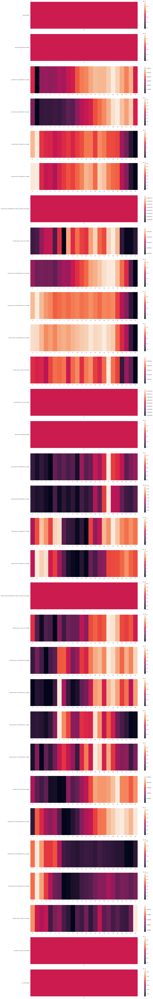

In [224]:
fig, axs = plt.subplots(len(gathered_distances.keys()))
fig.set_figwidth(25)
fig.set_figheight(6*len(gathered_distances.keys()))
j = 0
for k, v in gathered_distances.items():
    sns.heatmap([v], xticklabels=[i for i in range(len(v))], ax=axs[j])
    axs[j].set_yticklabels([k], rotation=0, fontsize="10", va="center")
    j += 1
plt.savefig('weights_drift.png', bbox_inches='tight', dpi=100)

## Analysis
ENCODER:
- impact mostly on Q (and on late layers)
- MLPs very slightly modified

DECODER:
- very slightly modified overall

# Representations comparison

In [220]:
prompts = [ ' \n Goal of the agent: go to the green ball \n Observation 0: A wall 2 step left, A purple key 1 step left and 2 steps forward, A yellow key 1 step left and 1 step forward, A green ball 3 steps forward, A grey ball 1 step right and 5 steps forward, A green key 1 step right and 2 steps forward, A grey ball 1 step right and 1 step forward, A green key 2 steps right and 4 steps forward, A red box 2 steps right and 2 steps forward, \n Action 0: ',
            ' \n Goal of the agent: go to the green ball \n Observation 0: A wall 2 step left, A purple key 1 step left and 2 steps forward, A yellow key 1 step left and 1 step forward, A green ball 3 steps forward, A grey ball 1 step right and 5 steps forward, A green key 1 step right and 2 steps forward, A grey ball 1 step right and 1 step forward, A green key 2 steps right and 4 steps forward, A red box 2 steps right and 2 steps forward, \n Action 0: go forward \n Observation 1: A purple key 1 step left and 1 step forward, A yellow key 1 step left, A green ball 2 steps forward, A grey ball 1 step right and 4 steps forward, A green key 1 step right and 1 step forward, A grey ball 1 step right, A green key 2 steps right and 3 steps forward, A red box 2 steps right and 1 step forward, \n Action 1: ',
            ' \n Goal of the agent: go to the green ball \n Observation 0: A wall 2 step left, A purple key 1 step left and 2 steps forward, A yellow key 1 step left and 1 step forward, A green ball 3 steps forward, A grey ball 1 step right and 5 steps forward, A green key 1 step right and 2 steps forward, A grey ball 1 step right and 1 step forward, A green key 2 steps right and 4 steps forward, A red box 2 steps right and 2 steps forward, \n Action 0: go forward \n Observation 1: A purple key 1 step left and 1 step forward, A yellow key 1 step left, A green ball 2 steps forward, A grey ball 1 step right and 4 steps forward, A green key 1 step right and 1 step forward, A grey ball 1 step right, A green key 2 steps right and 3 steps forward, A red box 2 steps right and 1 step forward, \n Action 1: turn right \n Observation 2: A wall 2 step right, A green key 3 steps left and 2 steps forward, A green ball 2 steps left, A red box 1 step left and 2 steps forward, A green key 1 step left and 1 step forward, A grey ball 1 step forward, \n Action 2: ',
            ' \n Goal of the agent: go to the purple box \n Observation 0: A wall 4 step forward, A red key 2 steps left and 1 step forward, A grey box 2 steps left, A purple box 1 step left and 1 step forward, A green key 2 steps right and 2 steps forward, A grey key 3 steps right and 2 steps forward, \n Action 0: ',
            ' \n Goal of the agent: go to the purple box \n Observation 0: A wall 4 step forward, A red key 2 steps left and 1 step forward, A grey box 2 steps left, A purple box 1 step left and 1 step forward, A green key 2 steps right and 2 steps forward, A grey key 3 steps right and 2 steps forward, \n Action 0: go forward \n Observation 1: A wall 3 step forward, A red key 2 steps left, A purple box 1 step left, A green key 2 steps right and 1 step forward, A grey key 3 steps right and 1 step forward, \n Action 1: ',
            ' \n Goal of the agent: go to the purple box \n Observation 0: A wall 4 step forward, A red key 2 steps left and 1 step forward, A grey box 2 steps left, A purple box 1 step left and 1 step forward, A green key 2 steps right and 2 steps forward, A grey key 3 steps right and 2 steps forward, \n Action 0: go forward \n Observation 1: A wall 3 step forward, A red key 2 steps left, A purple box 1 step left, A green key 2 steps right and 1 step forward, A grey key 3 steps right and 1 step forward, \n Action 1: go forward \n Observation 2: A wall 2 step forward, A wall 3 step left, A green key 2 steps right, A grey key 3 steps right, \n Action 2: ']

In [147]:
expected_answers = ['go forward', 'go forward', 'turn left', 'go forward', 'turn left', 'turn left', 'turn left'] 

In [148]:
def compute_forward(input_tokens, candidate_tokens):
    _model_input = {
        'input_ids': input_tokens["input_ids"],
        'attention_mask': input_tokens["attention_mask"],
        'decoder_input_ids': candidate_tokens["input_ids"],
        'decoder_attention_mask': candidate_tokens["attention_mask"],
        'output_hidden_states': True
    }
    with torch.no_grad():
        base_result = model(**_model_input)
        finetuned_result = finetuned_model(**_model_input)
    return base_result, finetuned_result

In [149]:
def compute_representation_distances(prompt, action):
    _input = tokenizer(prompt, return_tensors='pt')
    _output = tokenizer(action, return_tensors='pt')
    base_result, finetuned_result = compute_forward(_input, _output)
    def _compute_distances(key):
        distances = []
        for i in range(len(base_result[key])):
            distances.append(torch.abs(base_result[key][i][0, :, :] - finetuned_result[key][i][0, :, :]).mean(dim=1).numpy())
        return np.array(distances)
    
    encoder_distances = _compute_distances('encoder_hidden_states')
    decoder_distances = _compute_distances('decoder_hidden_states')
    return {
        'encoder': {
            'tokens': tokenizer.convert_ids_to_tokens(_input["input_ids"].tolist()[0]),
            'distances': encoder_distances
        },
        'decoder': {
            'tokens': tokenizer.convert_ids_to_tokens(_output["input_ids"].tolist()[0]),
            'distances': decoder_distances
        }
    }

In [150]:
def gather_by_token(distances, output_dict):
    for _idx, _token in enumerate(distances["tokens"]):
        if _token not in output_dict:
            output_dict[_token] = []
        output_dict[_token].append(distances["distances"][:, _idx])

In [151]:
def reduce_distances_per_token(distances):
    results = {}
    for _token, _distances in distances.items():
        results[_token] = np.array(_distances).mean(axis=0)
    _sorted = sorted({k: v[-2] for k,v in results.items()}.items(), key=itemgetter(1), reverse=True)
    return OrderedDict({k: results[k] for k in list(map(lambda _tuple: _tuple[0], _sorted))})

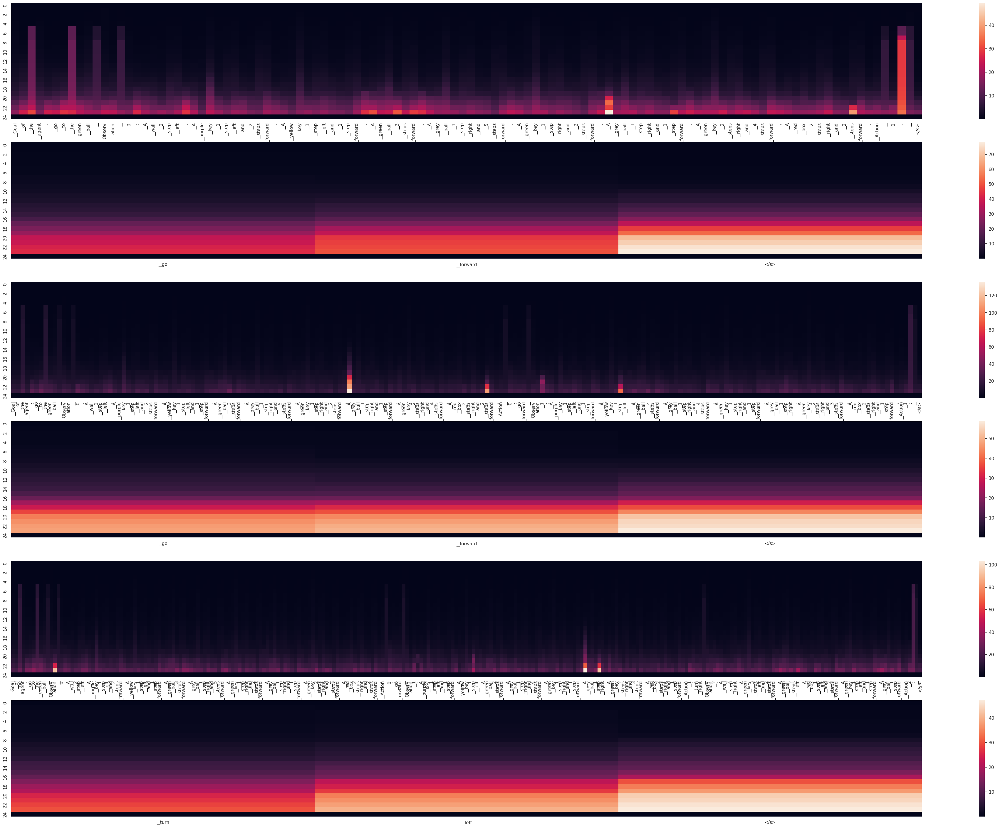

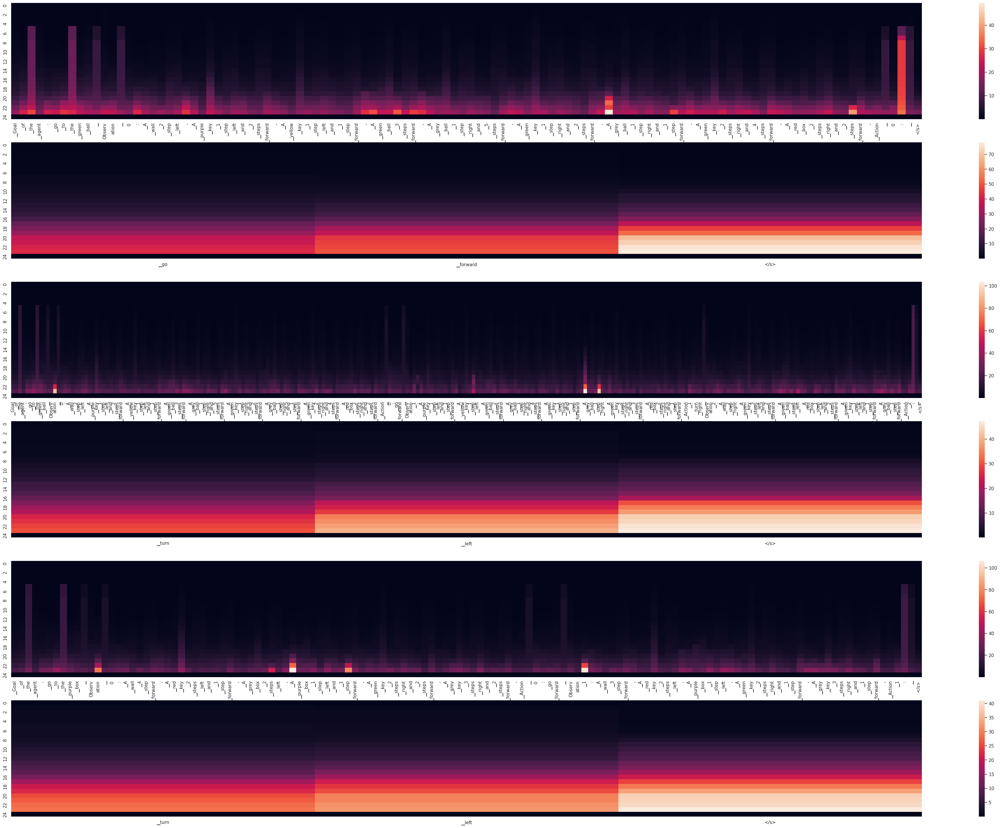

In [226]:
representation_distances_by_tokens = {
    "encoder": {},
    "decoder": {}
}
for _seed in range(2):
    fig, axs = plt.subplots(len(prompts)//2*2)
    fig.set_figwidth(50)
    fig.set_figheight(6*len(prompts)//2*2)
    for _idx in range(len(prompts)//2):
        _results = compute_representation_distances(prompts[_idx*_seed + _idx], expected_answers[_idx*_seed + _idx])
        gather_by_token(_results["encoder"], representation_distances_by_tokens["encoder"])
        gather_by_token(_results["decoder"], representation_distances_by_tokens["decoder"])
        sns.heatmap(_results["encoder"]["distances"], xticklabels=_results["encoder"]["tokens"], ax=axs[_idx*2])
        sns.heatmap(_results["decoder"]["distances"], xticklabels=_results["decoder"]["tokens"], ax=axs[_idx*2+1])
    plt.savefig(f'T5Large_representations_drift_by_layer_{_seed}.png', bbox_inches='tight', dpi=100)

## Analysis
- "The" is changed
- Deep modifications around previous actions taken.

In [153]:
encoder_distances = reduce_distances_per_token(representation_distances_by_tokens["encoder"])
decoder_distances = reduce_distances_per_token(representation_distances_by_tokens["decoder"])

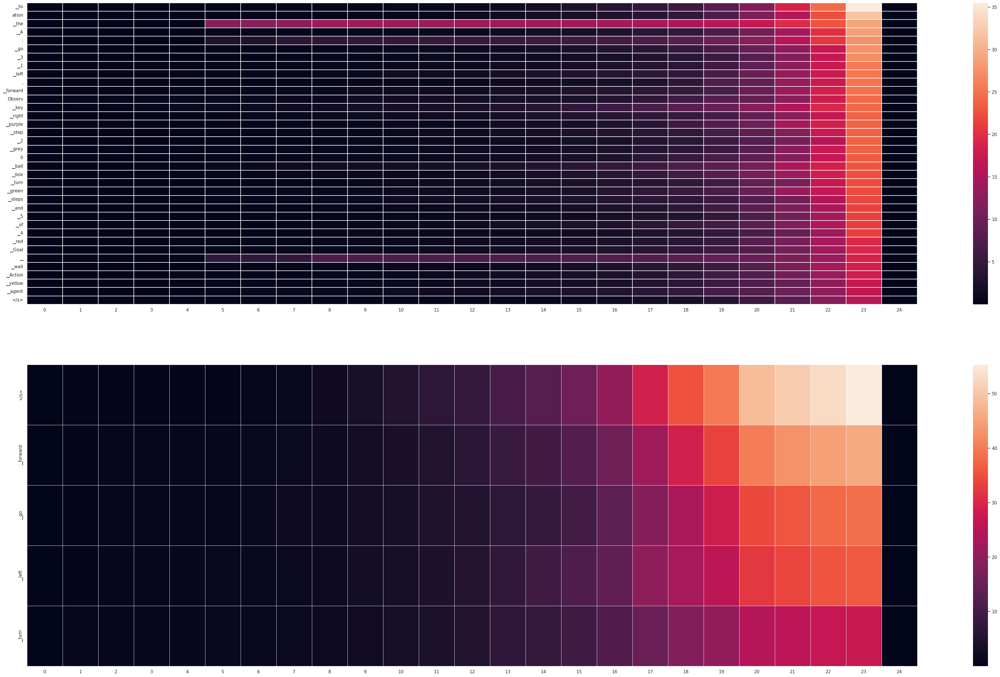

In [154]:
fig, axs = plt.subplots(2)
fig.set_figwidth(50)
fig.set_figheight(30)
sns.heatmap(list(encoder_distances.values()), yticklabels=encoder_distances.keys(), linewidth=.1, ax=axs[0])
sns.heatmap(list(decoder_distances.values()), yticklabels=decoder_distances.keys(), linewidth=.5, ax=axs[1])
plt.savefig('representations_drift_by_token.png', bbox_inches='tight', dpi=100)

## Analysis
- Interesting how some words are modified on all layers compared to some others that are only modified on last layers
- Hypothesis: Top 5 modified words are the one identifying the task or objects in the scene => model has learned how to focus on task instruction (and hence mostly modified attention query)

# Prompts

In [1]:
from lamorel.server.llms.module_functions.score_module_function import ScoreModuleFunction

/home/cromac/anaconda3/envs/lamorel/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [9]:
def call_models(prompt):
    def _generate(_model):
        results = _model.generate(tokenizer.encode(prompt, return_tensors='pt'),  
                                  max_new_tokens=50,
                                  do_sample=False,
                                  # temperature=None,
                                  # # top_p=0.90,
                                  # top_k=5,
                                  # num_return_sequences=5,
                                  # num_beams=1,
                                  return_dict_in_generate=True,
                                  output_scores=True)
        generated_sequences = results.sequences[:, 1:]
        _generated_texts = tokenizer.batch_decode(generated_sequences, skip_special_tokens=True)
        probabilities = torch.stack(results.scores, dim=1).softmax(-1)
        texts_probabilities = torch.gather(probabilities, 2, generated_sequences[:, :, None]).squeeze(-1)
        _scores = texts_probabilities.prod(-1)
        return _generated_texts, _scores
            
    base_generations = _generate(model)
    finetuned_generations = _generate(finetuned_model)
    return base_generations, finetuned_generations

In [10]:
def get_scores(prompt, candidate):
    _input = tokenizer(prompt, return_tensors='pt')
    _output = tokenizer(candidate)
    _output["input_ids"] = torch.tensor([[0] + _output["input_ids"]])
    _output["attention_mask"] = torch.tensor([[1] + _output["attention_mask"]])
    base_results, finetuned_result = compute_forward(_input, _output)
    fn = ScoreModuleFunction(0, "seq2seq")
    fn.device = 'cpu'
    def _get_score(forward_results):
        return fn(forward_results, {"decoder_input_ids": _output["input_ids"]}, None).item()
    return _get_score(base_results), _get_score(finetuned_result)

In [197]:
def prompt_analysis(prompt, candidate_generations=[], plot_name=None):
    def _text_wrap(text, width=80):
        import textwrap
        result_lines = [] 
        for line in text.split('\n'):
            result_lines.extend(textwrap.wrap(line.strip(), width=width))
        return '\n'.join(result_lines)
    
    nb_rows = max(2, len(candidate_generations))
    fig = plt.figure(figsize=(80, 60))
    widths = [0.6, 0.6, 1.]
    heights = [1 for _ in range(nb_rows)]
    gs = fig.add_gridspec(nb_rows, 3, width_ratios=widths, height_ratios=heights)
    
    # Prompt
    ax = fig.add_subplot(gs[0:1, 0])
    ax.set_axis_off()
    ax.set_title("Prompt:", loc='left', fontsize=50, fontweight="bold")
    ax.text(0.05, 0.98, 
            _text_wrap(prompt), 
            ha='left', va='top', fontsize=50, wrap=True)
    
    # Generations
    base_generations, finetuned_generations = call_models(prompt)
    ax = fig.add_subplot(gs[-1, 0])
    ax.set_axis_off()
    ax.set_title("Generation from base model:", fontsize=50, fontweight="bold")
    ax.text(0.5, 0.95, 
            _text_wrap(f"{base_generations[0][0]} ({round(base_generations[1][0].item(), 3)})", width=40), 
            ha="center", va="top", fontsize=50)
    ax = fig.add_subplot(gs[-1, 1])
    ax.set_axis_off()
    ax.set_title("Generation from finetuned model:", fontsize=50, fontweight="bold")
    ax.text(0.5, 0.95, 
            _text_wrap(f"{finetuned_generations[0][0]} ({round(finetuned_generations[1][0].item(), 3)})", width=40), 
            ha="center", va="top", fontsize=50)
    
    # Scorings
    for idx, _candidate in enumerate(candidate_generations):
        _scores = get_scores(prompt, _candidate)
        ax = fig.add_subplot(gs[idx, -1])
        g = sns.barplot(
            x=["Base", "Finetuned"], y=list(_scores)
        )
        ax.set_title(_text_wrap(f"<{_candidate}>", width=100), fontsize=50)
        g.set_ylabel("P",fontsize=36, rotation=0, labelpad=20.)
        g.tick_params(labelsize=36)
        ax.yaxis.get_offset_text().set_fontsize(32)
    if plot_name:
        plt.savefig(f'{plot_name}.png', dpi=100, bbox_inches="tight")

## Plan (5.1 + 5.5/5.7)

### Zero-shot

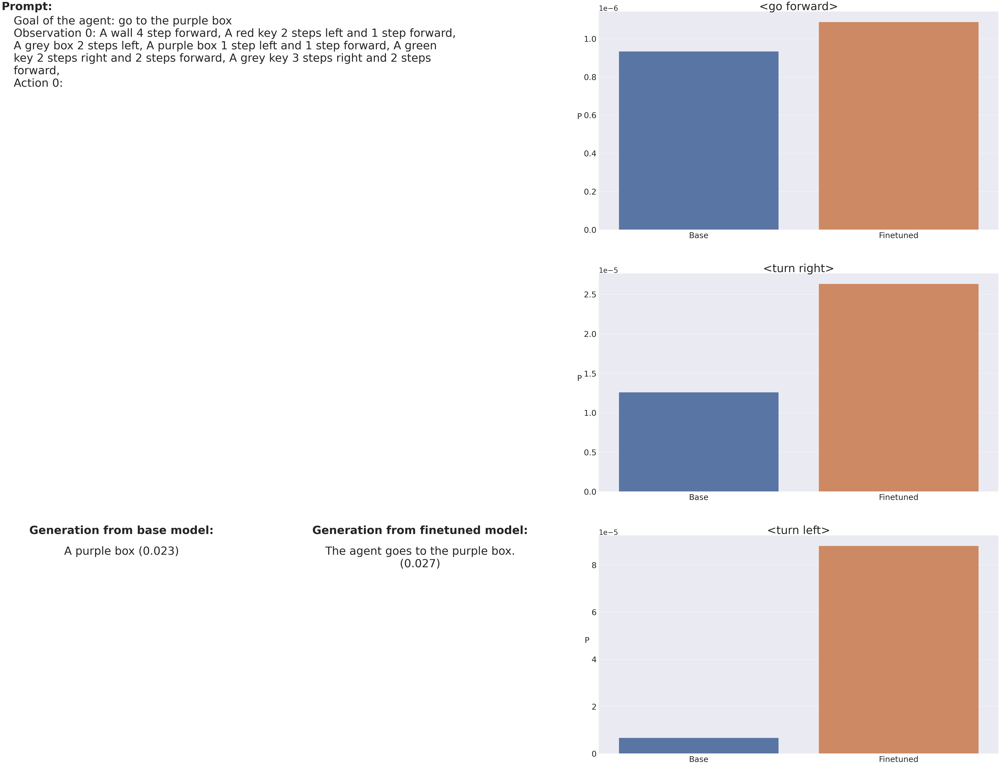

In [199]:
prompt_analysis(prompt="Goal of the agent: go to the purple box \n Observation 0: A wall 4 step forward, A red key 2 steps left and 1 step forward, A grey box 2 steps left, A purple box 1 step left and 1 step forward, A green key 2 steps right and 2 steps forward, A grey key 3 steps right and 2 steps forward, \n Action 0: ", 
                candidate_generations=["go forward", "turn right", "turn left"], plot_name="T5Large_Plan_0-shot")

=> Goes in the same way as my hypothesis: our finetuning does just what's enough to complete the tasks

=> all actions got their probability increased: makes sens because of our finetuning where we want to see only these three sequences

=> yet turn right is higher than go forward (which is wrong)

### Few-shot

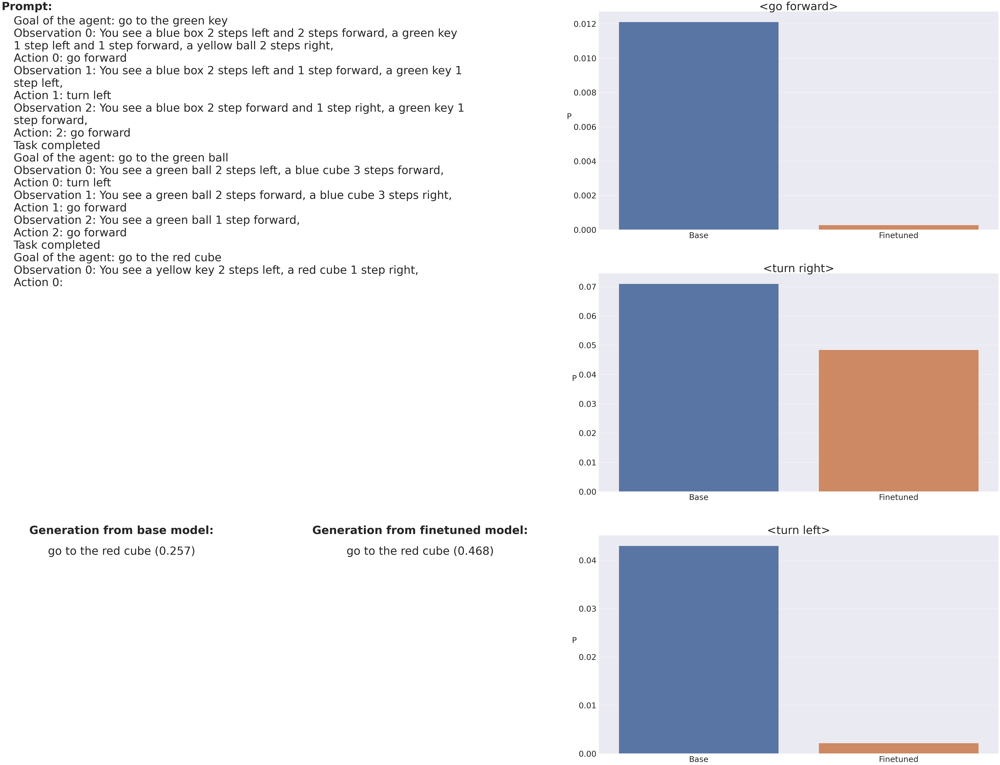

In [200]:
prompt_analysis(prompt="Goal of the agent: go to the green key \n Observation 0: You see a blue box 2 steps left and 2 steps forward, a green key 1 step left and 1 step forward, a yellow ball 2 steps right, \n Action 0: go forward \n Observation 1: You see a blue box 2 steps left and 1 step forward, a green key 1 step left, \n Action 1: turn left \n Observation 2: You see a blue box 2 step forward and 1 step right, a green key 1 step forward, \n Action: 2: go forward \n Task completed \n Goal of the agent: go to the green ball \n Observation 0: You see a green ball 2 steps left, a blue cube 3 steps forward, \n Action 0: turn left \n Observation 1: You see a green ball 2 steps forward, a blue cube 3 steps right, \n Action 1: go forward \n Observation 2: You see a green ball 1 step forward, \n Action 2: go forward \n Task completed \n Goal of the agent: go to the red cube \n Observation 0: You see a yellow key 2 steps left, a red cube 1 step right, \n Action 0: ", 
                candidate_generations=["go forward", "turn right", "turn left"], plot_name="T5Large_Plan_Few-shot_1")

=> higher proba on go to the red cube: as seen before, better learns to focus on the task

=> Proba of all actions went down => poor generalization on prompt template?

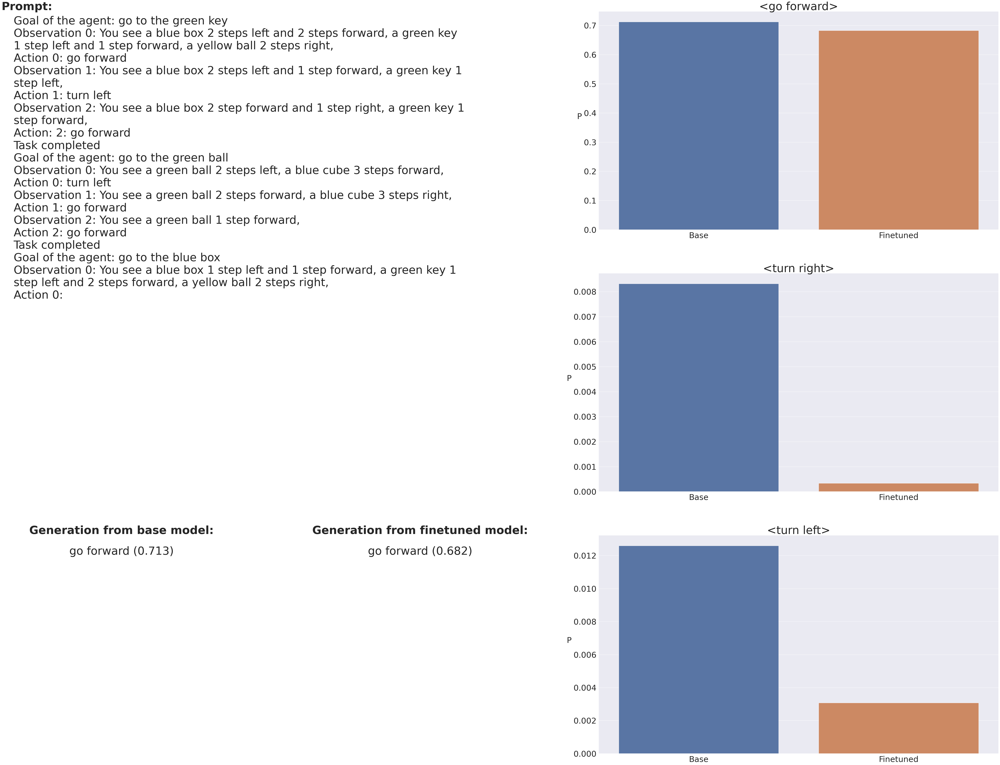

In [201]:
prompt_analysis(prompt="Goal of the agent: go to the green key \n Observation 0: You see a blue box 2 steps left and 2 steps forward, a green key 1 step left and 1 step forward, a yellow ball 2 steps right, \n Action 0: go forward \n Observation 1: You see a blue box 2 steps left and 1 step forward, a green key 1 step left, \n Action 1: turn left \n Observation 2: You see a blue box 2 step forward and 1 step right, a green key 1 step forward, \n Action: 2: go forward \n Task completed \n Goal of the agent: go to the green ball \n Observation 0: You see a green ball 2 steps left, a blue cube 3 steps forward, \n Action 0: turn left \n Observation 1: You see a green ball 2 steps forward, a blue cube 3 steps right, \n Action 1: go forward \n Observation 2: You see a green ball 1 step forward, \n Action 2: go forward \n Task completed \n Goal of the agent: go to the blue box \n Observation 0: You see a blue box 1 step left and 1 step forward, a green key 1 step left and 2 steps forward, a yellow ball 2 steps right, \n Action 0: ", 
                candidate_generations=["go forward", "turn right", "turn left"], plot_name="T5Large_Plan_Few-shot_2")

=> Proba of all actions went down => poor generalization on prompt template?

## Different goal formulation (5.4)

### Your task is to + goal

#### Zero-shot

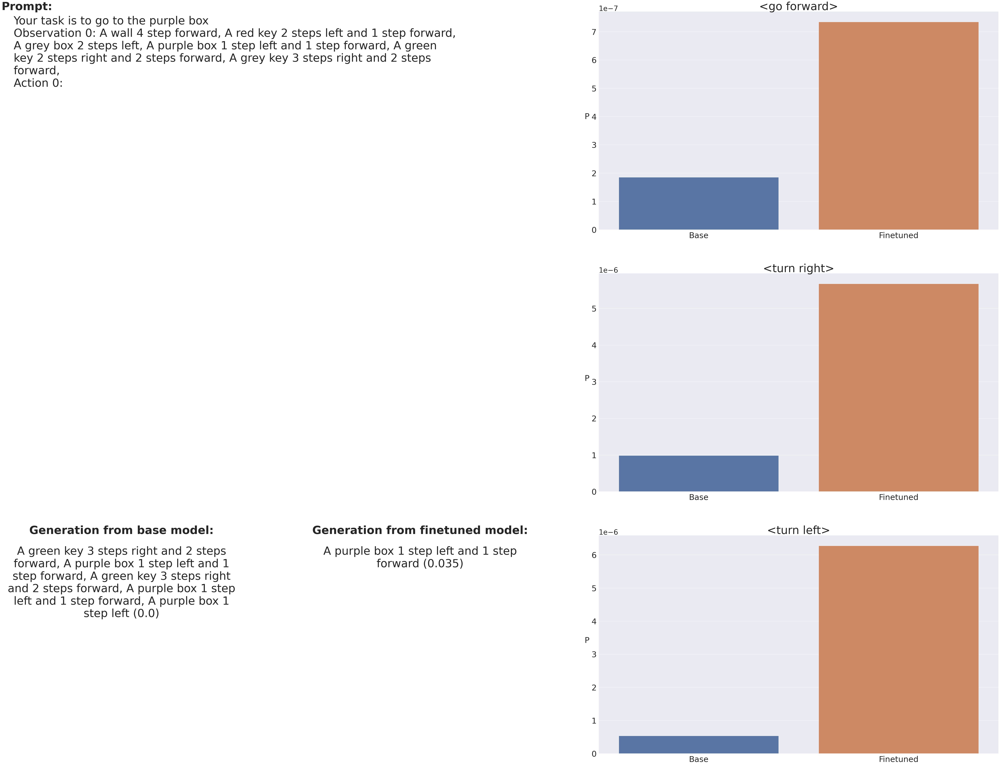

In [202]:
prompt_analysis(prompt="Your task is to go to the purple box \n Observation 0: A wall 4 step forward, A red key 2 steps left and 1 step forward, A grey box 2 steps left, A purple box 1 step left and 1 step forward, A green key 2 steps right and 2 steps forward, A grey key 3 steps right and 2 steps forward, \n Action 0: ", 
                candidate_generations=["go forward", "turn right", "turn left"], plot_name="T5Large_Goal_1_zero-shot")

=> Less free generation from finetuned

=> Proba of turn left still max (so good action)

#### Few-shot

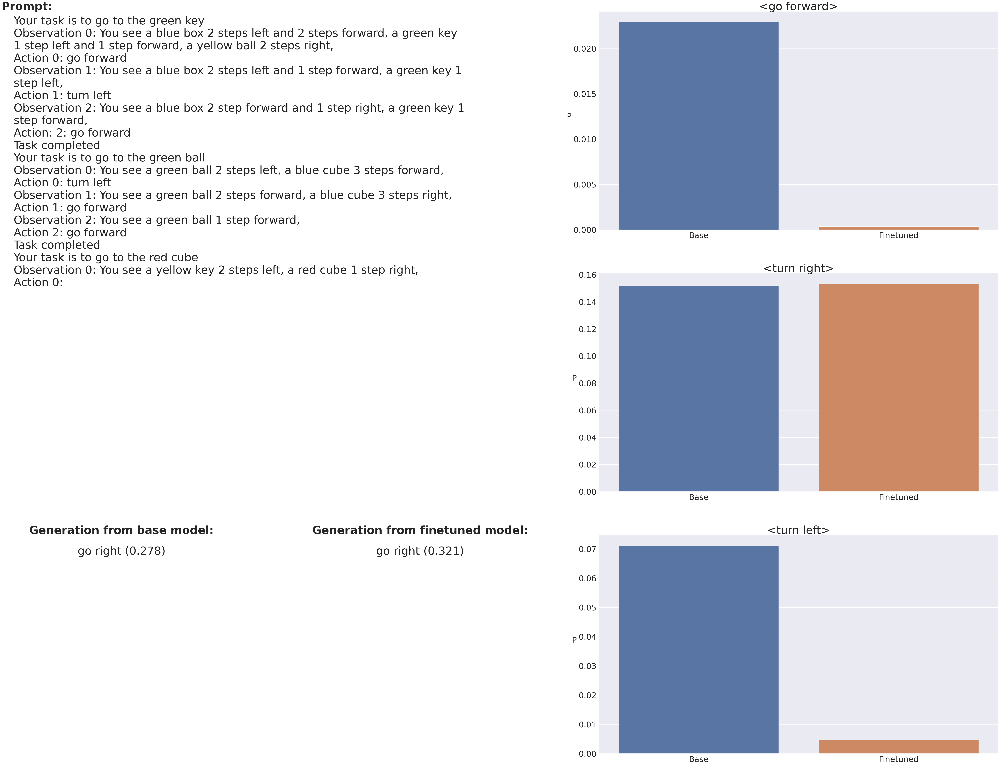

In [203]:
prompt_analysis(prompt="Your task is to go to the green key \n Observation 0: You see a blue box 2 steps left and 2 steps forward, a green key 1 step left and 1 step forward, a yellow ball 2 steps right, \n Action 0: go forward \n Observation 1: You see a blue box 2 steps left and 1 step forward, a green key 1 step left, \n Action 1: turn left \n Observation 2: You see a blue box 2 step forward and 1 step right, a green key 1 step forward, \n Action: 2: go forward \n Task completed \n Your task is to go to the green ball \n Observation 0: You see a green ball 2 steps left, a blue cube 3 steps forward, \n Action 0: turn left \n Observation 1: You see a green ball 2 steps forward, a blue cube 3 steps right, \n Action 1: go forward \n Observation 2: You see a green ball 1 step forward, \n Action 2: go forward \n Task completed \n Your task is to go to the red cube \n Observation 0: You see a yellow key 2 steps left, a red cube 1 step right, \n Action 0: ", 
                candidate_generations=["go forward", "turn right", "turn left"], plot_name="T5Large_Goal_1_few-shot_1")

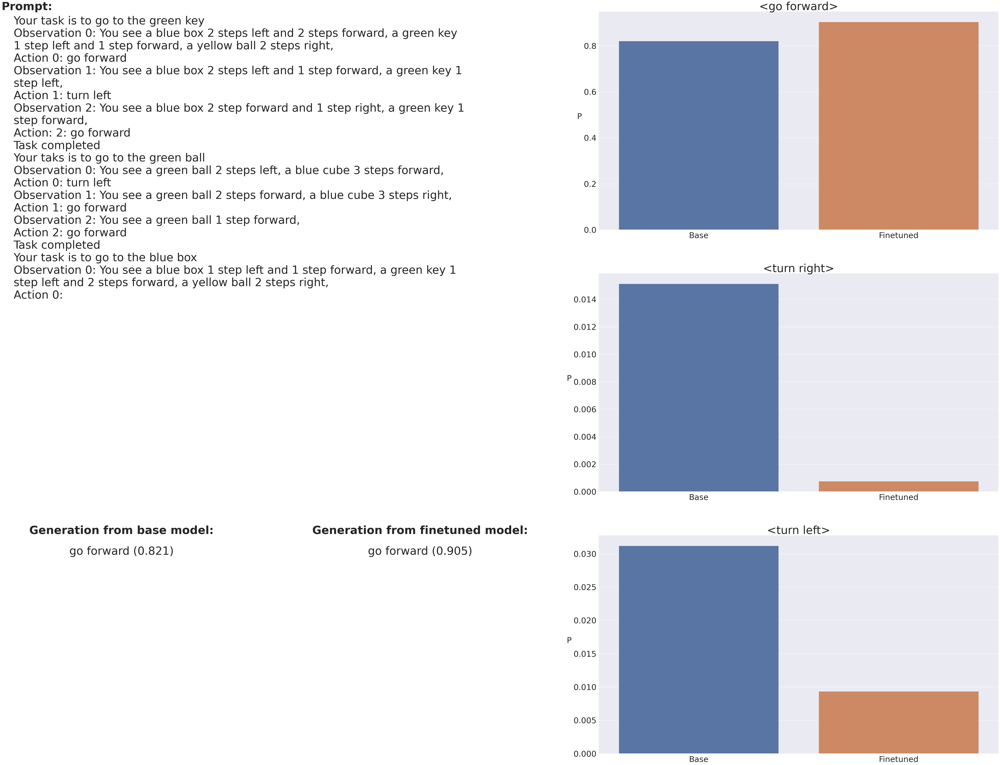

In [204]:
prompt_analysis(prompt="Your task is to go to the green key \n Observation 0: You see a blue box 2 steps left and 2 steps forward, a green key 1 step left and 1 step forward, a yellow ball 2 steps right, \n Action 0: go forward \n Observation 1: You see a blue box 2 steps left and 1 step forward, a green key 1 step left, \n Action 1: turn left \n Observation 2: You see a blue box 2 step forward and 1 step right, a green key 1 step forward, \n Action: 2: go forward \n Task completed \n Your taks is to go to the green ball \n Observation 0: You see a green ball 2 steps left, a blue cube 3 steps forward, \n Action 0: turn left \n Observation 1: You see a green ball 2 steps forward, a blue cube 3 steps right, \n Action 1: go forward \n Observation 2: You see a green ball 1 step forward, \n Action 2: go forward \n Task completed \n Your task is to go to the blue box \n Observation 0: You see a blue box 1 step left and 1 step forward, a green key 1 step left and 2 steps forward, a yellow ball 2 steps right, \n Action 0: ", 
                candidate_generations=["go forward", "turn right", "turn left"], plot_name="T5Large_Goal_1_few-shot_2")

=> Seem even better with this prompt

### Your task is to + goal (with reach)

#### Zero-shot

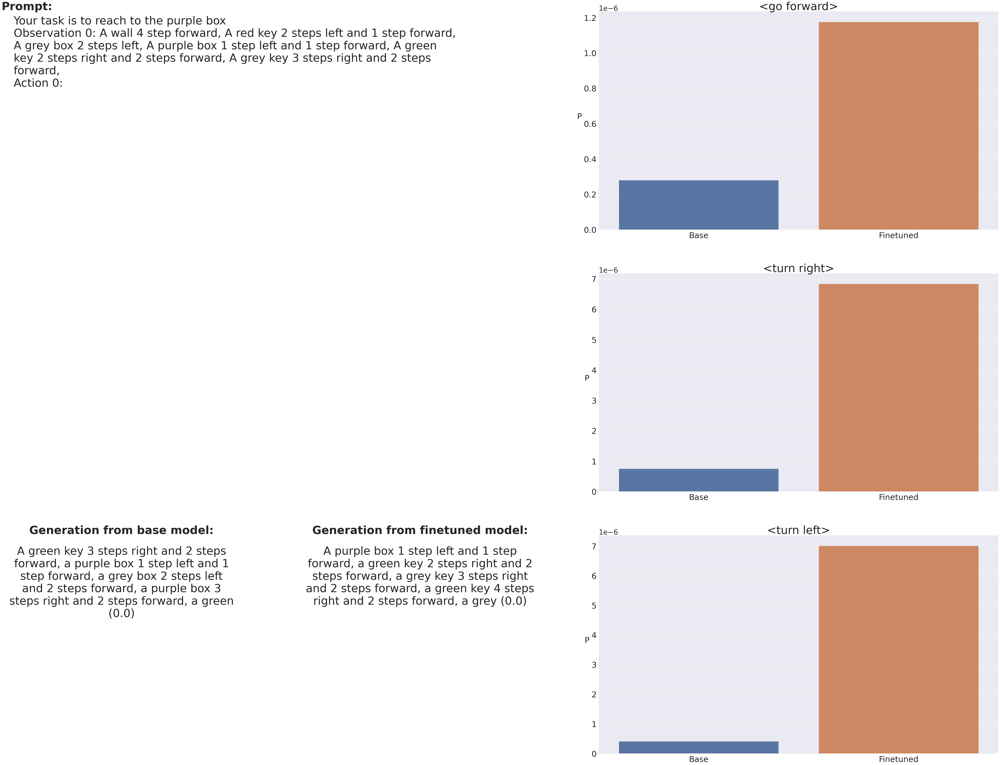

In [205]:
prompt_analysis(prompt="Your task is to reach to the purple box \n Observation 0: A wall 4 step forward, A red key 2 steps left and 1 step forward, A grey box 2 steps left, A purple box 1 step left and 1 step forward, A green key 2 steps right and 2 steps forward, A grey key 3 steps right and 2 steps forward, \n Action 0: ", 
                candidate_generations=["go forward", "turn right", "turn left"], plot_name="T5Large_Goal_2_zero-shot")

=> Would still choose the right action but reach has made things harder

#### Few-shot

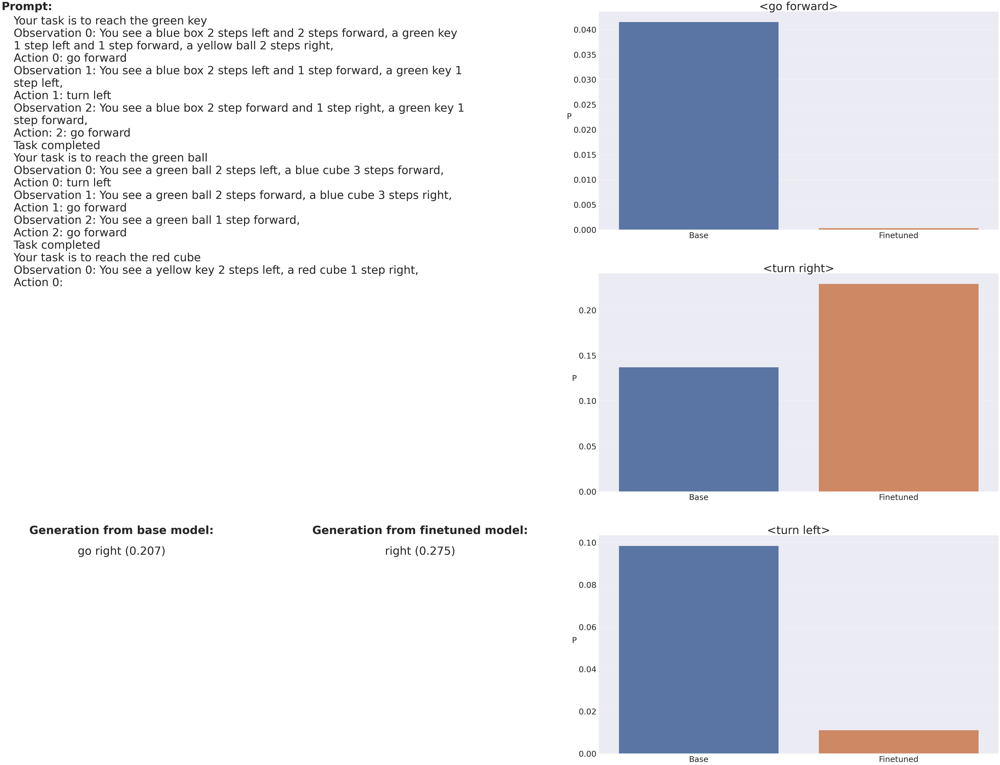

In [206]:
prompt_analysis(prompt="Your task is to reach the green key \n Observation 0: You see a blue box 2 steps left and 2 steps forward, a green key 1 step left and 1 step forward, a yellow ball 2 steps right, \n Action 0: go forward \n Observation 1: You see a blue box 2 steps left and 1 step forward, a green key 1 step left, \n Action 1: turn left \n Observation 2: You see a blue box 2 step forward and 1 step right, a green key 1 step forward, \n Action: 2: go forward \n Task completed \n Your task is to reach the green ball \n Observation 0: You see a green ball 2 steps left, a blue cube 3 steps forward, \n Action 0: turn left \n Observation 1: You see a green ball 2 steps forward, a blue cube 3 steps right, \n Action 1: go forward \n Observation 2: You see a green ball 1 step forward, \n Action 2: go forward \n Task completed \n Your task is to reach the red cube \n Observation 0: You see a yellow key 2 steps left, a red cube 1 step right, \n Action 0: ", 
                candidate_generations=["go forward", "turn right", "turn left"], plot_name="T5Large_Goal_2_few-shot_1")

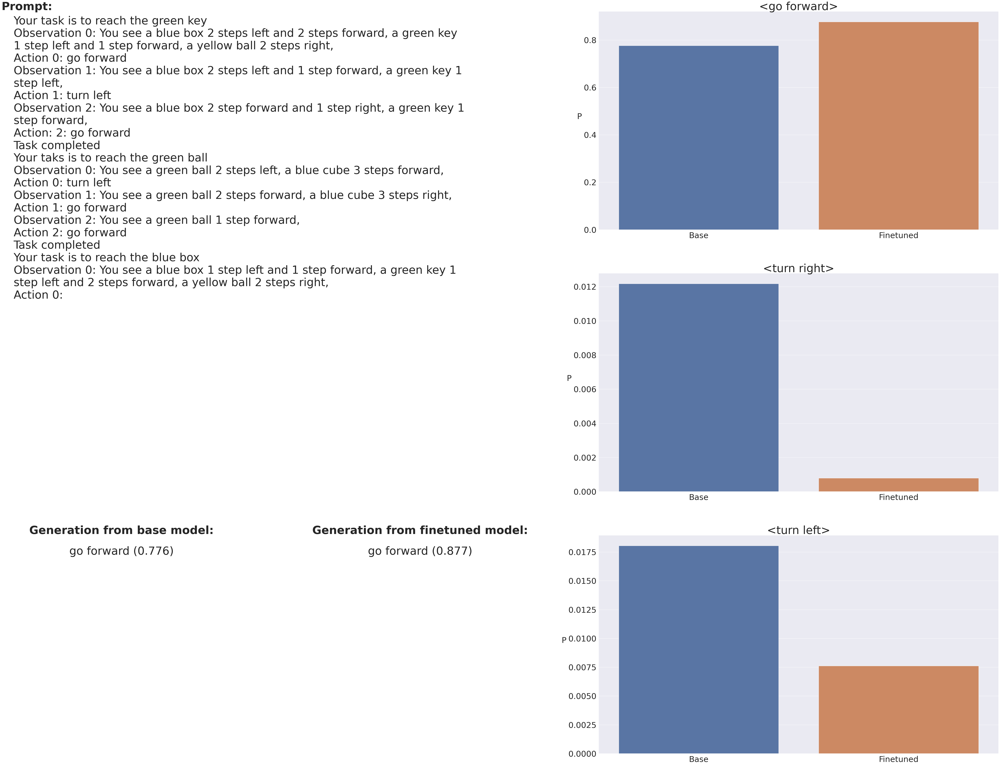

In [207]:
prompt_analysis(prompt="Your task is to reach the green key \n Observation 0: You see a blue box 2 steps left and 2 steps forward, a green key 1 step left and 1 step forward, a yellow ball 2 steps right, \n Action 0: go forward \n Observation 1: You see a blue box 2 steps left and 1 step forward, a green key 1 step left, \n Action 1: turn left \n Observation 2: You see a blue box 2 step forward and 1 step right, a green key 1 step forward, \n Action: 2: go forward \n Task completed \n Your taks is to reach the green ball \n Observation 0: You see a green ball 2 steps left, a blue cube 3 steps forward, \n Action 0: turn left \n Observation 1: You see a green ball 2 steps forward, a blue cube 3 steps right, \n Action 1: go forward \n Observation 2: You see a green ball 1 step forward, \n Action 2: go forward \n Task completed \n Your task is to reach the blue box \n Observation 0: You see a blue box 1 step left and 1 step forward, a green key 1 step left and 2 steps forward, a yellow ball 2 steps right, \n Action 0: ", 
                candidate_generations=["go forward", "turn right", "turn left"], plot_name="T5Large_Goal_2_few-shot_2")

=> Good in few shot!

### Question + goal (with reach)

#### Zero-shot

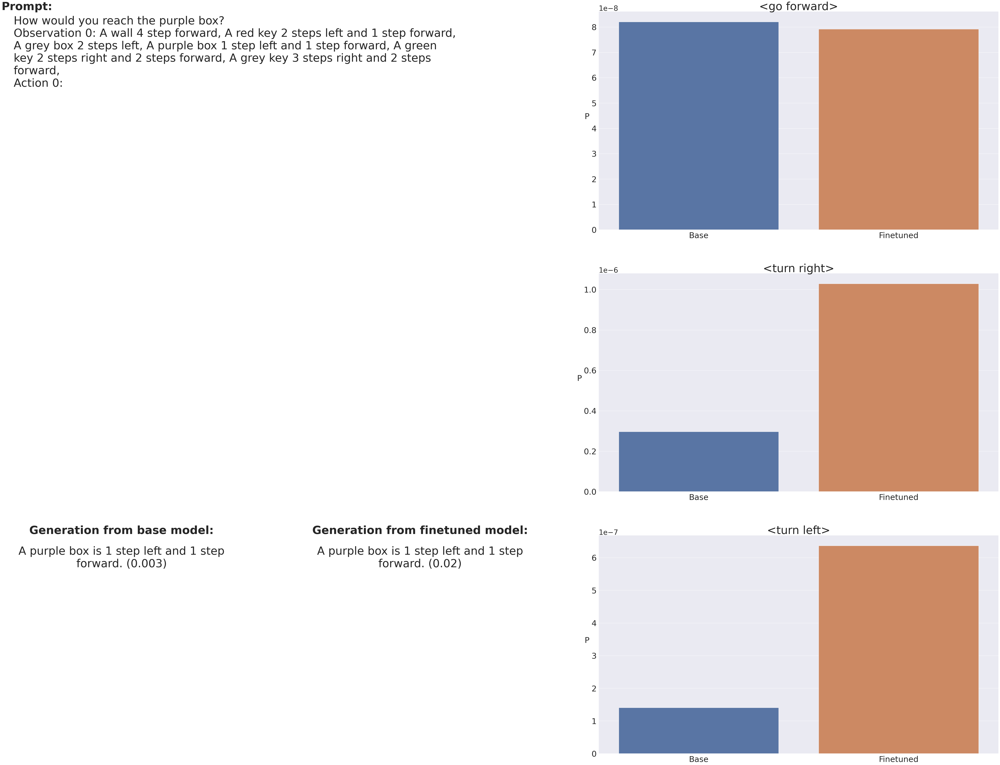

In [230]:
prompt_analysis(prompt="How would you reach the purple box? \n Observation 0: A wall 4 step forward, A red key 2 steps left and 1 step forward, A grey box 2 steps left, A purple box 1 step left and 1 step forward, A green key 2 steps right and 2 steps forward, A grey key 3 steps right and 2 steps forward, \n Action 0: ", 
                candidate_generations=["go forward", "turn right", "turn left"], plot_name="T5Large_Goal_3_zero-shot")

=> Whoop triggered something here => would fail choosing the right action

#### Few-shot

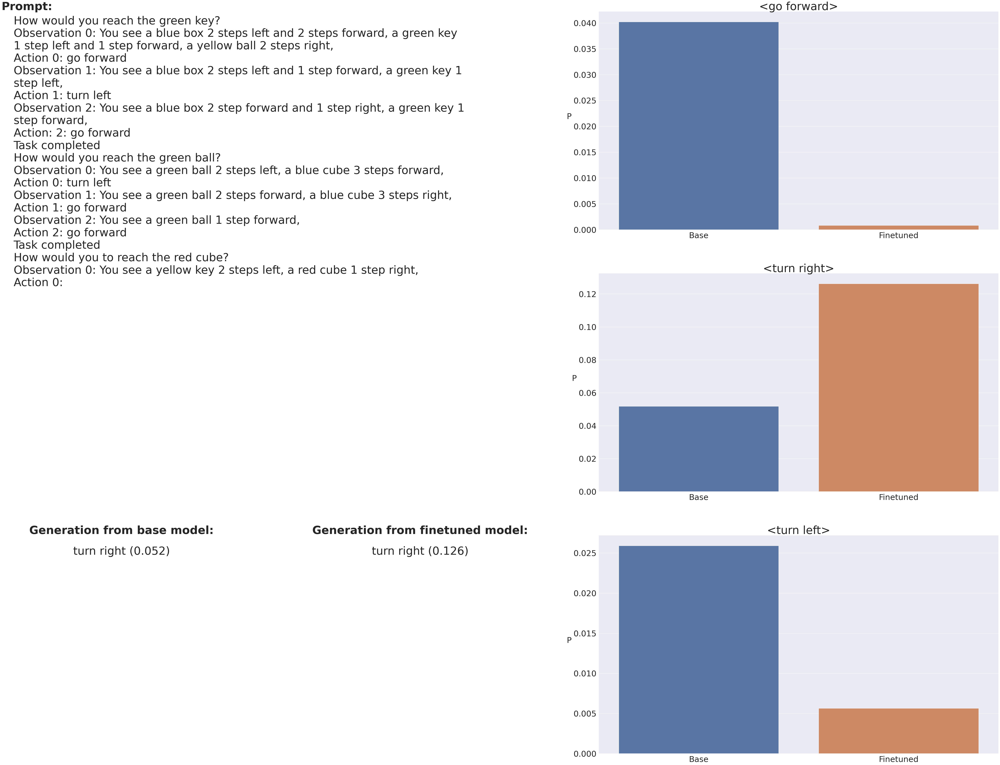

In [209]:
prompt_analysis(prompt="How would you reach the green key? \n Observation 0: You see a blue box 2 steps left and 2 steps forward, a green key 1 step left and 1 step forward, a yellow ball 2 steps right, \n Action 0: go forward \n Observation 1: You see a blue box 2 steps left and 1 step forward, a green key 1 step left, \n Action 1: turn left \n Observation 2: You see a blue box 2 step forward and 1 step right, a green key 1 step forward, \n Action: 2: go forward \n Task completed \n How would you reach the green ball? \n Observation 0: You see a green ball 2 steps left, a blue cube 3 steps forward, \n Action 0: turn left \n Observation 1: You see a green ball 2 steps forward, a blue cube 3 steps right, \n Action 1: go forward \n Observation 2: You see a green ball 1 step forward, \n Action 2: go forward \n Task completed \n How would you to reach the red cube? \n Observation 0: You see a yellow key 2 steps left, a red cube 1 step right, \n Action 0: ", 
                candidate_generations=["go forward", "turn right", "turn left"], plot_name="T5Large_Goal_3_few-shot_1")

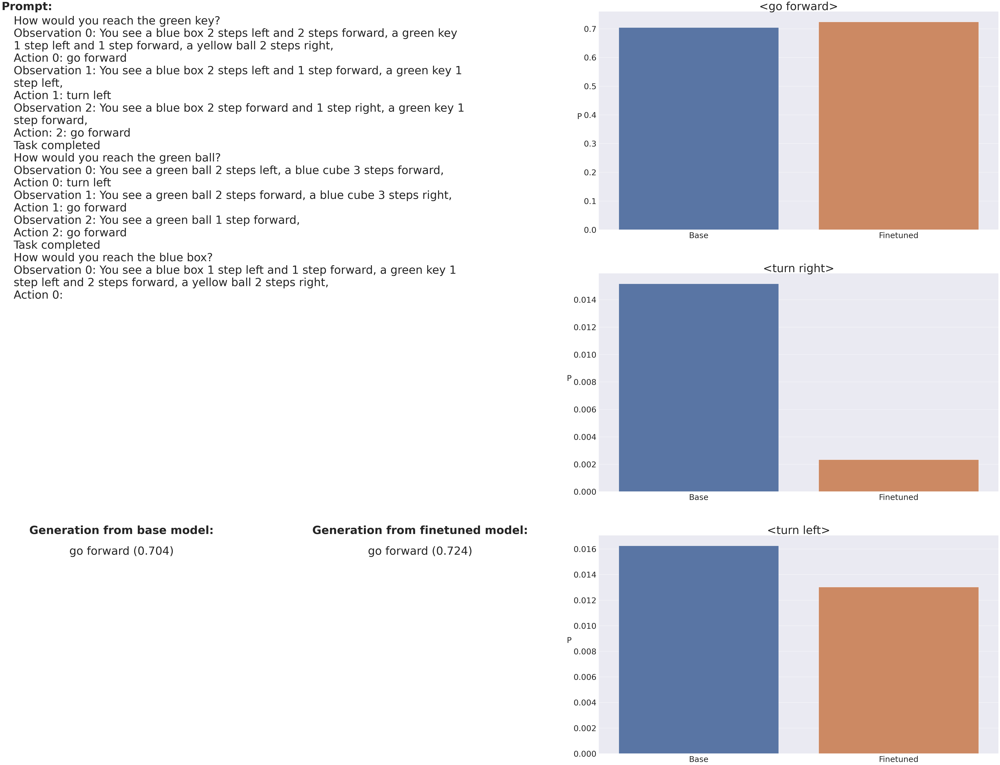

In [210]:
prompt_analysis(prompt="How would you reach the green key? \n Observation 0: You see a blue box 2 steps left and 2 steps forward, a green key 1 step left and 1 step forward, a yellow ball 2 steps right, \n Action 0: go forward \n Observation 1: You see a blue box 2 steps left and 1 step forward, a green key 1 step left, \n Action 1: turn left \n Observation 2: You see a blue box 2 step forward and 1 step right, a green key 1 step forward, \n Action: 2: go forward \n Task completed \n How would you reach the green ball? \n Observation 0: You see a green ball 2 steps left, a blue cube 3 steps forward, \n Action 0: turn left \n Observation 1: You see a green ball 2 steps forward, a blue cube 3 steps right, \n Action 1: go forward \n Observation 2: You see a green ball 1 step forward, \n Action 2: go forward \n Task completed \n How would you reach the blue box? \n Observation 0: You see a blue box 1 step left and 1 step forward, a green key 1 step left and 2 steps forward, a yellow ball 2 steps right, \n Action 0: ", 
                candidate_generations=["go forward", "turn right", "turn left"], plot_name="T5Large_Goal_3_few-shot_2")

=> Handles question in few-shot

=> Would have handled it before finetuning also but better confidence afetwards

## Inverted spatial words

In [175]:
def inverse_words(word_a, word_b, prompt):
    return prompt.replace(word_a, "__TMP_TOKEN__").replace(word_b, word_a).replace("__TMP_TOKEN__", word_b)

### Zero-shot

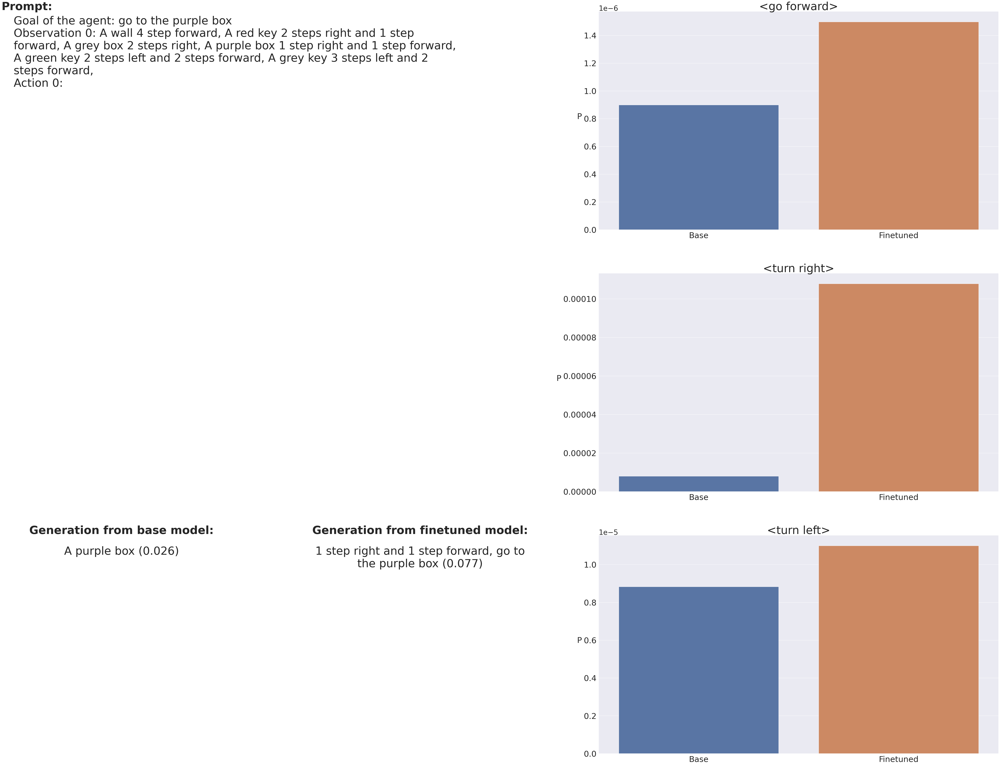

In [227]:
prompt_analysis(prompt=inverse_words(
                            "left", "right",
                            "Goal of the agent: go to the purple box \n Observation 0: A wall 4 step forward, A red key 2 steps left and 1 step forward, A grey box 2 steps left, A purple box 1 step left and 1 step forward, A green key 2 steps right and 2 steps forward, A grey key 3 steps right and 2 steps forward, \n Action 0: "
                        ), 
                candidate_generations=["go forward", "turn right", "turn left"], plot_name="T5Large_Inverted_zero-shot")

=> finetuned seem to better handle new positions? Finetuned does focus more on important things

### Few-shot

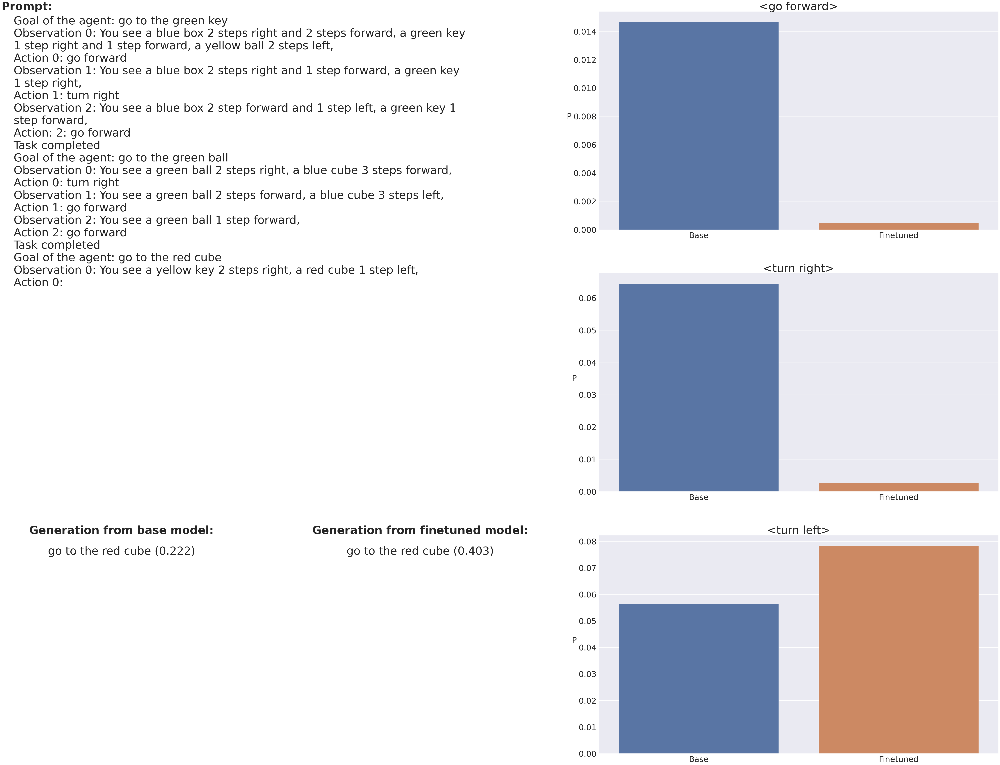

In [228]:
prompt_analysis(prompt=inverse_words(
                            "left", "right",
                            "Goal of the agent: go to the green key \n Observation 0: You see a blue box 2 steps left and 2 steps forward, a green key 1 step left and 1 step forward, a yellow ball 2 steps right, \n Action 0: go forward \n Observation 1: You see a blue box 2 steps left and 1 step forward, a green key 1 step left, \n Action 1: turn left \n Observation 2: You see a blue box 2 step forward and 1 step right, a green key 1 step forward, \n Action: 2: go forward \n Task completed \n Goal of the agent: go to the green ball \n Observation 0: You see a green ball 2 steps left, a blue cube 3 steps forward, \n Action 0: turn left \n Observation 1: You see a green ball 2 steps forward, a blue cube 3 steps right, \n Action 1: go forward \n Observation 2: You see a green ball 1 step forward, \n Action 2: go forward \n Task completed \n Goal of the agent: go to the red cube \n Observation 0: You see a yellow key 2 steps left, a red cube 1 step right, \n Action 0: ",
                        ), 
                candidate_generations=["go forward", "turn right", "turn left"], plot_name="T5Large_Inverted_few-shot_1")

=> base would have chosen right

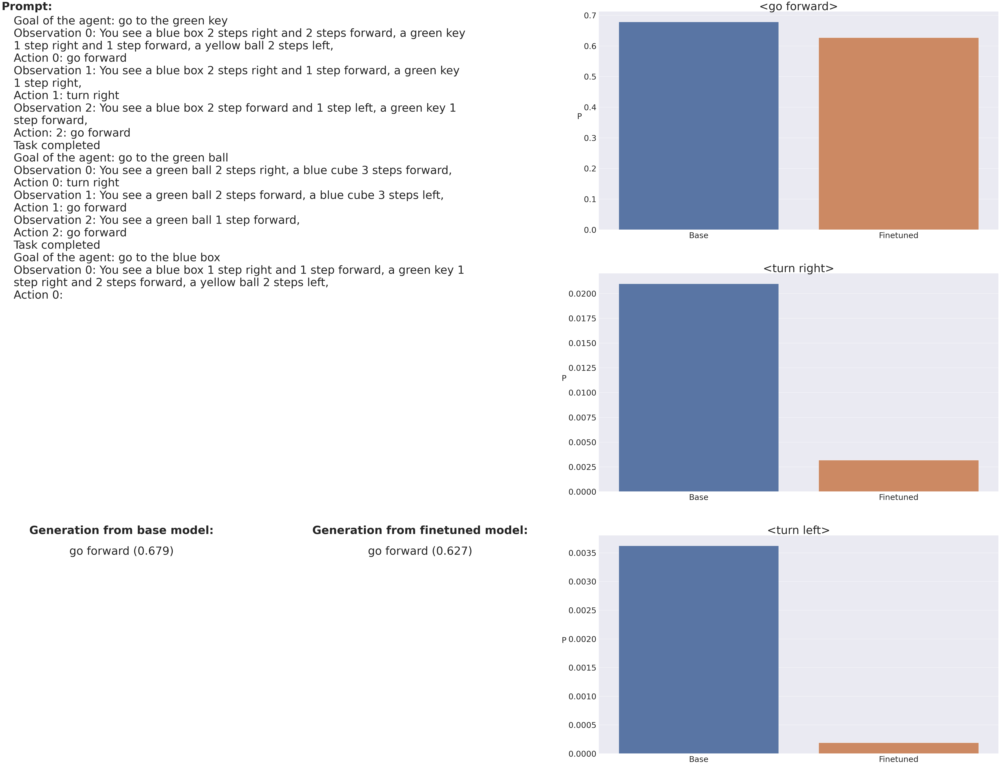

In [229]:
prompt_analysis(prompt=inverse_words(
                            "left", "right",
                            "Goal of the agent: go to the green key \n Observation 0: You see a blue box 2 steps left and 2 steps forward, a green key 1 step left and 1 step forward, a yellow ball 2 steps right, \n Action 0: go forward \n Observation 1: You see a blue box 2 steps left and 1 step forward, a green key 1 step left, \n Action 1: turn left \n Observation 2: You see a blue box 2 step forward and 1 step right, a green key 1 step forward, \n Action: 2: go forward \n Task completed \n Goal of the agent: go to the green ball \n Observation 0: You see a green ball 2 steps left, a blue cube 3 steps forward, \n Action 0: turn left \n Observation 1: You see a green ball 2 steps forward, a blue cube 3 steps right, \n Action 1: go forward \n Observation 2: You see a green ball 1 step forward, \n Action 2: go forward \n Task completed \n Goal of the agent: go to the blue box \n Observation 0: You see a blue box 1 step left and 1 step forward, a green key 1 step left and 2 steps forward, a yellow ball 2 steps right, \n Action 0: ",
                        ), 
                candidate_generations=["go forward", "turn right", "turn left"], plot_name="T5Large_Inverted_few-shot_2")

=> finetuned reduced a lot proba of wrong actions

## CoT (~5.3)

### Few-shot

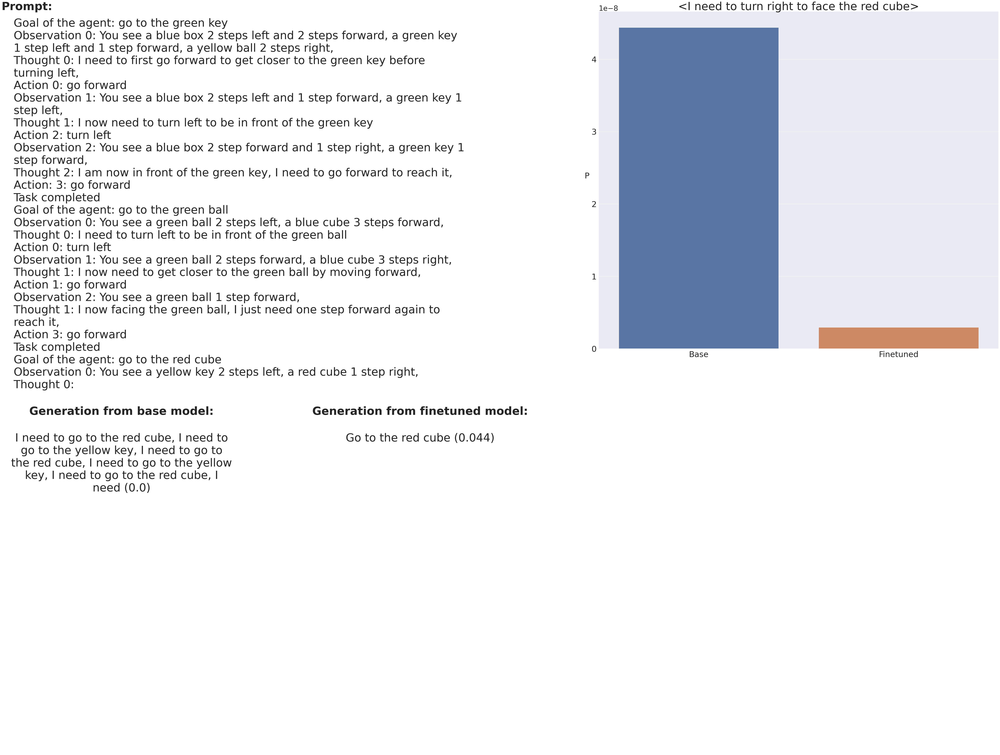

In [214]:
prompt_analysis(prompt="Goal of the agent: go to the green key \n Observation 0: You see a blue box 2 steps left and 2 steps forward, a green key 1 step left and 1 step forward, a yellow ball 2 steps right, \n Thought 0: I need to first go forward to get closer to the green key before turning left, \n Action 0: go forward \n Observation 1: You see a blue box 2 steps left and 1 step forward, a green key 1 step left, \n Thought 1: I now need to turn left to be in front of the green key \n Action 2: turn left \n Observation 2: You see a blue box 2 step forward and 1 step right, a green key 1 step forward, \n Thought 2: I am now in front of the green key, I need to go forward to reach it, \n Action: 3: go forward \n Task completed \n Goal of the agent: go to the green ball \n Observation 0: You see a green ball 2 steps left, a blue cube 3 steps forward, \n Thought 0: I need to turn left to be in front of the green ball \n Action 0: turn left \n Observation 1: You see a green ball 2 steps forward, a blue cube 3 steps right, \n Thought 1: I now need to get closer to the green ball by moving forward, \n Action 1: go forward \n Observation 2: You see a green ball 1 step forward, \n Thought 1: I now facing the green ball, I just need one step forward again to reach it, \n Action 3: go forward \n Task completed \n Goal of the agent: go to the red cube \n Observation 0: You see a yellow key 2 steps left, a red cube 1 step right, \n Thought 0: ", 
                candidate_generations=["I need to turn right to face the red cube"], plot_name="T5Large_CoT_few-shot_1")

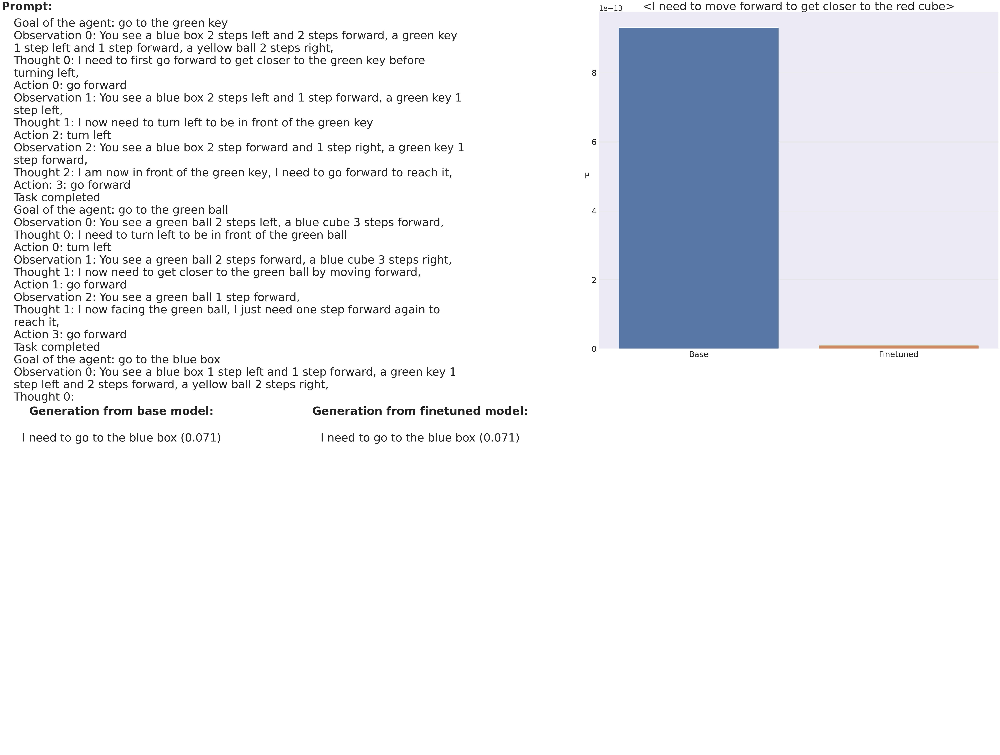

In [215]:
prompt_analysis(prompt="Goal of the agent: go to the green key \n Observation 0: You see a blue box 2 steps left and 2 steps forward, a green key 1 step left and 1 step forward, a yellow ball 2 steps right, \n Thought 0: I need to first go forward to get closer to the green key before turning left, \n Action 0: go forward \n Observation 1: You see a blue box 2 steps left and 1 step forward, a green key 1 step left, \n Thought 1: I now need to turn left to be in front of the green key \n Action 2: turn left \n Observation 2: You see a blue box 2 step forward and 1 step right, a green key 1 step forward, \n Thought 2: I am now in front of the green key, I need to go forward to reach it, \n Action: 3: go forward \n Task completed \n Goal of the agent: go to the green ball \n Observation 0: You see a green ball 2 steps left, a blue cube 3 steps forward, \n Thought 0: I need to turn left to be in front of the green ball \n Action 0: turn left \n Observation 1: You see a green ball 2 steps forward, a blue cube 3 steps right, \n Thought 1: I now need to get closer to the green ball by moving forward, \n Action 1: go forward \n Observation 2: You see a green ball 1 step forward, \n Thought 1: I now facing the green ball, I just need one step forward again to reach it, \n Action 3: go forward \n Task completed \n Goal of the agent: go to the blue box \n Observation 0: You see a blue box 1 step left and 1 step forward, a green key 1 step left and 2 steps forward, a yellow ball 2 steps right, \n Thought 0: ", 
                candidate_generations=["I need to move forward to get closer to the red cube"], plot_name="T5Large_CoT_few-shot_2")

=> Finetuning had negative impact on expected thoughts

## Outcome prediction (5.3)

### Zero-shot

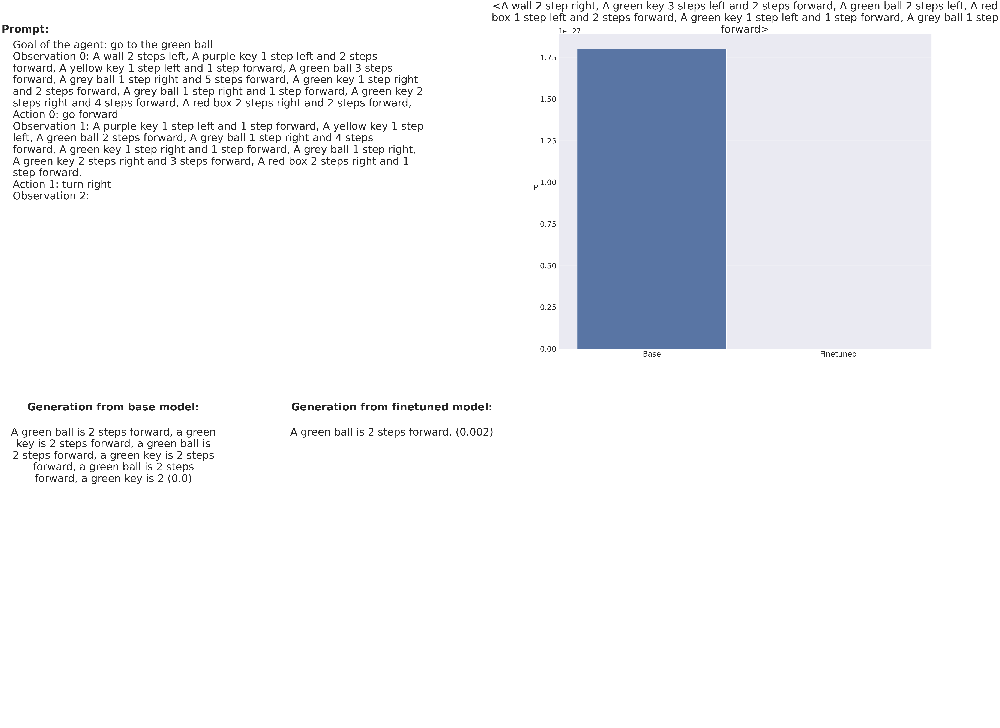

In [216]:
prompt_analysis(prompt="Goal of the agent: go to the green ball \n Observation 0: A wall 2 steps left, A purple key 1 step left and 2 steps forward, A yellow key 1 step left and 1 step forward, A green ball 3 steps forward, A grey ball 1 step right and 5 steps forward, A green key 1 step right and 2 steps forward, A grey ball 1 step right and 1 step forward, A green key 2 steps right and 4 steps forward, A red box 2 steps right and 2 steps forward, \n Action 0: go forward \n Observation 1: A purple key 1 step left and 1 step forward, A yellow key 1 step left, A green ball 2 steps forward, A grey ball 1 step right and 4 steps forward, A green key 1 step right and 1 step forward, A grey ball 1 step right, A green key 2 steps right and 3 steps forward, A red box 2 steps right and 1 step forward, \n Action 1: turn right \n Observation 2: ", 
                candidate_generations=["A wall 2 step right, A green key 3 steps left and 2 steps forward, A green ball 2 steps left, A red box 1 step left and 2 steps forward, A green key 1 step left and 1 step forward, A grey ball 1 step forward"], plot_name="T5Large_Outcome_zero-shot")

=> negative impact on zero-shot

### Few-shot

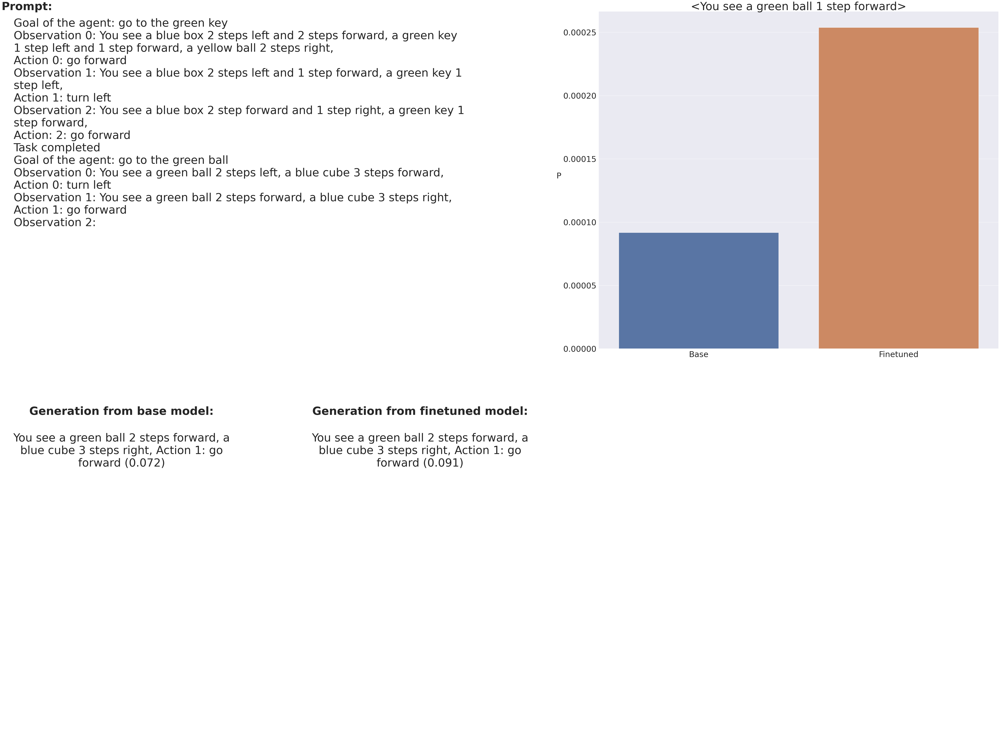

In [217]:
prompt_analysis(prompt="Goal of the agent: go to the green key \n Observation 0: You see a blue box 2 steps left and 2 steps forward, a green key 1 step left and 1 step forward, a yellow ball 2 steps right, \n Action 0: go forward \n Observation 1: You see a blue box 2 steps left and 1 step forward, a green key 1 step left, \n Action 1: turn left \n Observation 2: You see a blue box 2 step forward and 1 step right, a green key 1 step forward, \n Action: 2: go forward \n Task completed \n Goal of the agent: go to the green ball \n Observation 0: You see a green ball 2 steps left, a blue cube 3 steps forward, \n Action 0: turn left \n Observation 1: You see a green ball 2 steps forward, a blue cube 3 steps right, \n Action 1: go forward \n Observation 2: ", 
                candidate_generations=["You see a green ball 1 step forward"], plot_name="T5Large_Outcome_few-shot_1")

=> positive impact on few-shot

## QA

### Open questions

In [214]:
prompt = "You see a blue box 2 steps left and 2 steps forward, a green key 1 step left and 1 step forward, a yellow ball 2 steps right. Where is the blue box? "
call_models(prompt)
get_scores(prompt, "2 steps left and 2 steps forward")

Base model:
2 steps left: 0.2245868593454361
Finetuned model:
2 steps left: 0.26421403884887695
Scores for <2 steps left and 2 steps forward>
Base model:
0.1696297973394394
Finetuned model:
0.1804966926574707


In [215]:
prompt = "You see a blue box 2 steps left and 2 steps forward, a green key 1 step left and 1 step forward, a yellow ball 2 steps right. Where is the yellow ball? "
call_models(prompt)

Base model:
2 steps right: 0.40404215455055237
Finetuned model:
2 steps right: 0.47926655411720276


In [217]:
prompt = "You see a blue box 1 step left and 2 steps forward, a green key 2 steps forward, a yellow ball 2 steps right. Where is the green key? "
call_models(prompt)

Base model:
2 steps forward: 0.7313823103904724
Finetuned model:
2 steps forward: 0.9027676582336426


In [218]:
prompt = "You see a blue box 1 step left and 2 steps forward, a green key 2 steps forward, a yellow ball 2 steps right. Where is the green key? "
get_scores(prompt, "next to the blue box")

Scores for <next to the blue box>
Base model:
0.00021345178538467735
Finetuned model:
5.4613388783764094e-05


=> negative impact on relative positions understanding